In [1]:
import glob
import shutil
import random
import os
import json
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as patches

## Annotations von LILA Science mit MegaDetector



In [9]:
# JSON-Datei laden
json_file = "JSONs/desert-lion-camera-traps_detections.json"
#Hauptordner mit Bildern
image_root = "desert-lion-camera-traps-images"  

with open(json_file, "r") as f:
    data = json.load(f)


# keys ausgeben
print(data.keys())


# Mapping von Kategorien
category_mapping = {cat["id"]: cat["name"] for cat in data["categories"]}

dict_keys(['info', 'images', 'annotations', 'categories'])


In [ ]:
# alle Bilder in der JSON durchgehen
for img_data in data["images"]:
    img_rel_path = img_data["file"]  # Relativer Pfad
    img_abs_path = os.path.join(image_root, img_rel_path)  # Absoluter Pfad

    if not os.path.exists(img_abs_path):
        print(f"Bild nicht gefunden: {img_abs_path}")
        continue

    img = cv2.imread(img_abs_path)
    if img is None:
        print(f"Konnte Bild nicht laden: {img_abs_path}")
        continue

    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    height, width, _ = img.shape

    # Bounding Boxes zeichnen
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.imshow(img)

    for det in img_data.get("detections", []):
        x, y, w, h = det["bbox"]
        x1, y1 = x * width, y * height
        x2, y2 = (x + w) * width, (y + h) * height

        category_id = int(det["category"])
        category_name = category_mapping.get(category_id, "Unknown")
        confidence = det["conf"]  # Confidence-Wert

        label_text = f"{category_name} ({confidence:.2f})"  # Format: 'panthera leo (0.95)'

        # Bounding Box
        rect = plt.Rectangle((x1, y1), w * width, h * height, linewidth=2, edgecolor='g', facecolor='none')
        ax.add_patch(rect)

        # Text mit Confidence
        ax.text(x1, y1 - 5, label_text, fontsize=10, color='white',
                bbox=dict(facecolor='green', alpha=0.6, edgecolor='none'))

    plt.axis("off")  # Achsen ausblenden
    plt.show()  

    # Manuelle Steuerung
    user_input = input("Drücke Enter für das nächste Bild oder 'q' zum Beenden: ").strip().lower()
    if user_input == "q":
        print("Beenden...")
        break

    plt.close()  # Schließe das Bild vor dem nächsten Durchgang


In [ ]:
# prüfen ob ein bild keine bounding box hat 
import cv2


def check_images(json_path, image_root):
    with open(json_path, "r") as f:
        data = json.load(f)

    for img_data in data["images"]:
        img_rel_path = img_data["file"]
        img_abs_path = os.path.join(image_root, img_rel_path)

        if not os.path.exists(img_abs_path):
            print(f"Bild nicht gefunden: {img_abs_path}")
            continue

        img = cv2.imread(img_abs_path)
        if img is None:
            print(f"Konnte Bild nicht laden: {img_abs_path}")
            continue

        if not img_data.get("detections"):
            print(f"Keine Bounding Boxes für {img_abs_path} gefunden!")

    print("Überprüfung abgeschlossen!")


json_path = "desert-lion-camera-traps_detections.json"
image_root = "desert-lion-camera-traps-images"

# Überprüfe die Bilder
check_images(json_path, image_root)


In [ ]:
# Bild, das angezeigt werden soll
target_image_path = "antidorcas marsupialis/Camera Trap/Hoanib/Hnb_Fldpln/31011/PvL_seq_2e42c1ff-433e-444c-8372-975ee920c5d8/PICT0285.JPG"

# Bild in der JSON suchen
target_image_data = None
for img_data in data["images"]:
    if img_data["file"] == target_image_path:
        target_image_data = img_data
        break

if target_image_data is None:
    print(f"Bild nicht in JSON gefunden: {target_image_path}")
else:
    img_abs_path = os.path.join(image_root, target_image_path)  # Absoluter Pfad

    if not os.path.exists(img_abs_path):
        print(f"Bild nicht gefunden: {img_abs_path}")
    else:
        img = cv2.imread(img_abs_path)
        if img is None:
            print(f"Konnte Bild nicht laden: {img_abs_path}")
        else:
            # OpenCV nutzt BGR, Matplotlib erwartet RGB
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            height, width, _ = img.shape

            # Bild anzeigen mit Bounding Boxes
            fig, ax = plt.subplots(figsize=(10, 6))
            ax.imshow(img)

            for det in target_image_data.get("detections", []):
                x, y, w, h = det["bbox"]
                x1, y1 = x * width, y * height
                x2, y2 = (x + w) * width, (y + h) * height

                category_id = int(det["category"])
                category_name = category_mapping.get(category_id, "Unknown")
                confidence = det["conf"]  # Confidence-Wert

                label_text = f"{category_name} ({confidence:.2f})"

                # Bounding Box
                rect = plt.Rectangle((x1, y1), w * width, h * height, linewidth=2, edgecolor='g', facecolor='none')
                ax.add_patch(rect)

                # Text mit Confidence
                ax.text(x1, y1 - 5, label_text, fontsize=10, color='white',
                        bbox=dict(facecolor='green', alpha=0.6, edgecolor='none'))

            plt.axis("off")  # Achsen ausblenden
            plt.show()

### Neue JSON in COCO Format für balanced_dataset


In [ ]:
# liste der unterordner in balanced_dataset
categories = os.listdir("balanced_dataset")
print(categories)

# gültige Kategorien
valid_categories = [
    'acinonyx jubatus', 'antidorcas marsupialis', 'aves', 'canis mesomelas', 'cn-francolins', 
    'cn-owls', 'cn-raptors', 'columbidae', 'corvus albus', 'corvus capensis', 'crocuta crocuta', 
    'diceros bicornis', 'equus asinus', 'equus zebra hartmannae', 'eupodotis rueppellii', 
    'giraffa camelopardalis', 'hyaena brunnea', 'hystrix africaeaustralis', 'lepus capensis', 
    'loxodanta africana', 'mellivora capensis', 'neotis ludwigii', 'numididae', 'oreotragus oreotragus', 
    'oryx gazella', 'otocyon megalotis', 'panthera leo', 'panthera pardus', 'papio anubis', 
    'procavia capensis', 'pronolagus randensis', 'pteroclidae', 'raphiceros campestris', 'struthio camelus', 
    'torgos tracheliotos', 'tragelaphus strepsiceros', 'vulpes chama'
]

['acinonyx jubatus', 'antidorcas marsupialis', 'aves', 'canis mesomelas', 'cn-francolins', 'cn-owls', 'cn-raptors', 'columbidae', 'corvus albus', 'corvus capensis', 'crocuta crocuta', 'diceros bicornis', 'equus asinus', 'equus zebra hartmannae', 'eupodotis rueppellii', 'giraffa camelopardalis', 'hyaena brunnea', 'hystrix africaeaustralis', 'lepus capensis', 'loxodanta africana', 'mellivora capensis', 'neotis ludwigii', 'numididae', 'oreotragus oreotragus', 'oryx gazella', 'otocyon megalotis', 'panthera leo', 'panthera pardus', 'papio anubis', 'procavia capensis', 'pronolagus randensis', 'pteroclidae', 'raphiceros campestris', 'struthio camelus', 'torgos tracheliotos', 'tragelaphus strepsiceros', 'vulpes chama']


In [ ]:
import json
import os

# Pfade zur JSON-Datei
old_json_path = "JSONs/desert-lion-camera-traps_detections.json"
new_json_path = "JSONs/balanced_dataset_detections_new.json"

# Neuer Hauptordner für Bilder
new_image_root = "balanced_dataset"

# ursprüngliche JSON-Datei laden
with open(old_json_path, "r") as f:
    data = json.load(f)

# Mapping: `[category]_[file]` -> Neuer Pfad
image_mapping = {}

print("Starte Bild-Mapping...")

for category in os.listdir(new_image_root):
    category_path = os.path.join(new_image_root, category)
    if os.path.isdir(category_path):  # Nur echte Ordner berücksichtigen
        for img in os.listdir(category_path):
            full_name = img.lower()  # z. B. "acinonyx jubatus_20110222-PICT6562.JPG"
            image_mapping[full_name] = os.path.join(category, img)  # Neuer relativer Pfad

print(f"{len(image_mapping)} Bilder im Mapping gefunden.")

# Neue JSON-Daten vorbereiten
new_images = []
new_annotations = []
seen_images = set()  # Set für eindeutige Bilder
seen_annotations = set()  # Set für eindeutige Annotationen

missing_images = 0
kept_annotations = 0

# Bilder mit neuem Pfad übernehmen
for img_data in data["images"]:
    old_path = img_data["file"]  # Originaler Pfad
    old_path = old_path.replace("\\", "/")  
    file_name = os.path.basename(old_path).lower()  # Nur Dateiname extrahieren
    category_name = old_path.split("/")[0].lower()  # Kategorie aus Pfad extrahieren

    # Neuer erwarteter Name: `[category]_[filename]`
    new_file_key = f"{category_name}_{file_name}"  

    # Prüfen, ob das Bild existiert
    if new_file_key in image_mapping:
        new_file_path = image_mapping[new_file_key]  # Neuer relativer Pfad
        new_file_path = new_file_path.replace("\\", "/")  # Stelle sicher, dass der Pfad "/" statt "\\" verwendet

        # Sicherstellen, dass das Bild nur einmal hinzugefügt wird
        if new_file_path not in seen_images:
            img_data["file"] = new_file_path
            new_images.append(img_data)
            seen_images.add(new_file_path)  # Bild als hinzugefügt markieren

        # Passende Annotationen aktualisieren
        for ann in data["annotations"]:
            if ann["image_id"] == old_path:  # image_id ist gleich file path
                # Überprüfe, ob 'bbox' existiert
                bbox = tuple(ann["bbox"]) if "bbox" in ann else None

                # Eindeutige Annotation erstellen
                ann_key = (ann["image_id"], ann["category_id"], bbox)

                if ann_key not in seen_annotations:
                    ann["image_id"] = new_file_path  # Neuer Pfad
                    new_annotations.append(ann)
                    seen_annotations.add(ann_key)
                    kept_annotations += 1
    else:
        missing_images += 1
        print(f"Bild nicht gefunden: {old_path} → Gesucht als: {new_file_key}") 

# Neue JSON-Datei schreiben
new_data = {
    "info": data["info"],
    "categories": data["categories"],  
    "images": new_images,
    "annotations": new_annotations,
}

with open(new_json_path, "w") as f:
    json.dump(new_data, f, indent=4)

# *Debugging-Ausgabe
print(f"Neue JSON gespeichert unter: {new_json_path}")
print(f"Behaltene Bilder: {len(new_images)}")
print(f"Behaltene Annotationen: {kept_annotations}")
print(f"Fehlende Bilder (wurden entfernt): {missing_images}")

🔎 Starte Bild-Mapping...
✅ 9993 Bilder im Mapping gefunden.
⚠ Bild nicht gefunden: alopochen aegyptiacus/Camera Trap/2014/05/PvL_seq_dcd6ea4e-14a8-4435-961a-073c99ef4f81/20140526-PICT0403.JPG → Gesucht als: alopochen aegyptiacus_20140526-pict0403.jpg
⚠ Bild nicht gefunden: alopochen aegyptiacus/Camera Trap/Hoanib/Auses/PvL_seq_2de57fd3-165c-4e10-a208-02ee5864251c/PICT0049.JPG → Gesucht als: alopochen aegyptiacus_pict0049.jpg
⚠ Bild nicht gefunden: alopochen aegyptiacus/Camera Trap/Hoanib/Auses/PvL_seq_2de57fd3-165c-4e10-a208-02ee5864251c/PICT0050.JPG → Gesucht als: alopochen aegyptiacus_pict0050.jpg
⚠ Bild nicht gefunden: alopochen aegyptiacus/Camera Trap/Hoanib/Auses/PvL_seq_2de57fd3-165c-4e10-a208-02ee5864251c/PICT0051.JPG → Gesucht als: alopochen aegyptiacus_pict0051.jpg
⚠ Bild nicht gefunden: alopochen aegyptiacus/Camera Trap/South/Uniabmouth/21Dec11/PvL_seq_fd3aa2f3-f1f1-4e21-a8bd-c73e648e42ee/PICT0076.JPG → Gesucht als: alopochen aegyptiacus_pict0076.jpg
⚠ Bild nicht gefunden: al

In [2]:
from collections import Counter

orginial_json = "JSONs/balanced_dataset_detections_new.json"  

with open(orginial_json, "r") as f:
    data = json.load(f)


# Zähle, wie oft jedes Bild in "images" vorkommt
image_filenames = [img["file"] for img in data["images"]]
duplicate_images = [img for img, count in Counter(image_filenames).items() if count > 1]

if duplicate_images:
    print(f"⚠️ Fehler: {len(duplicate_images)} Bilder kommen mehrfach in `images` vor!")
    print("Beispiel-Duplikate:", duplicate_images[:10])
else:
    print("Kein Problem: Jedes Bild ist nur einmal in `images` vorhanden.")

Kein Problem: Jedes Bild ist nur einmal in `images` vorhanden.


In [ ]:
# Pfade anpassen
json_path = "JSONs/balanced_dataset_detections_new.json"  # JSON-Datei
dataset_path = "balanced_dataset"  # Bilder-Ordner

# Bild, das angezeigt werden soll
target_image = "pteroclidae/pteroclidae_20160323-PICT3188.JPG"

# JSON laden
with open(json_path, "r") as f:
    data = json.load(f)

# Bilddaten aus der JSON suchen
image_data = next((img for img in data["images"] if img["file"] == target_image), None)

if image_data is None:
    print(f"⚠️ Bild {target_image} nicht in JSON gefunden!")
else:
    # Bildpfad bestimmen
    img_path = os.path.join(dataset_path, target_image)
    
    if not os.path.exists(img_path):
        print(f"Bilddatei nicht gefunden: {img_path}")
    else:
        # Bild laden
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  

        # Bounding Boxen aus `detections` extrahieren
        detections = image_data.get("detections", [])

        # Bounding Boxen einzeichnen
        for det in detections:
            bbox = det["bbox"]  # Bounding Box-Koordinaten (relativ)
            category_id = det["category"]  # Kategorie-ID
            confidence = det["conf"]  # Konfidenzwert

            # Bounding Box skalieren (COCO-Format nutzt relative Werte zwischen 0-1)
            x, y, w, h = int(bbox[0] * img.shape[1]), int(bbox[1] * img.shape[0]), int(bbox[2] * img.shape[1]), int(bbox[3] * img.shape[0])

            # Bounding Box zeichnen
            cv2.rectangle(img, (x, y), (x + w, y + h), (255, 0, 0), 2)
            cv2.putText(img, f"ID: {category_id} ({confidence:.2f})", (x, y - 5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

        # Bild mit Bounding Boxen anzeigen
        plt.figure(figsize=(8, 8))
        plt.imshow(img)
        plt.title(f"Bounding Boxen für {target_image}")
        plt.axis("off")
        plt.show()

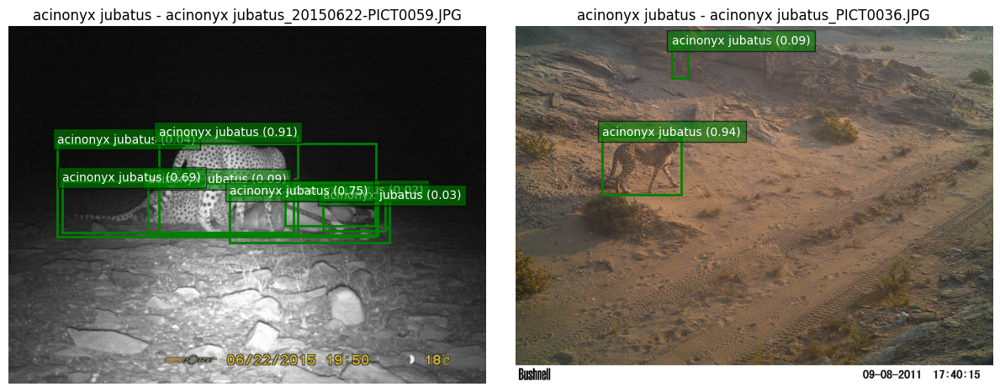

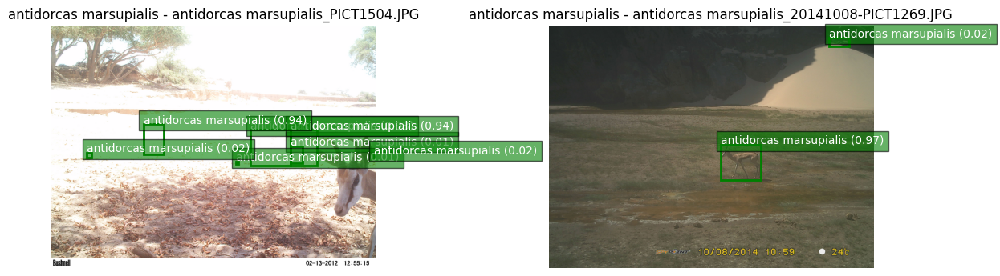

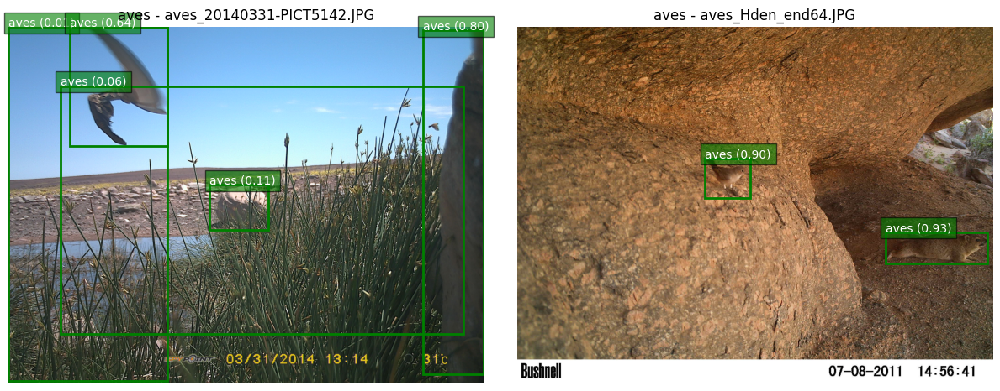

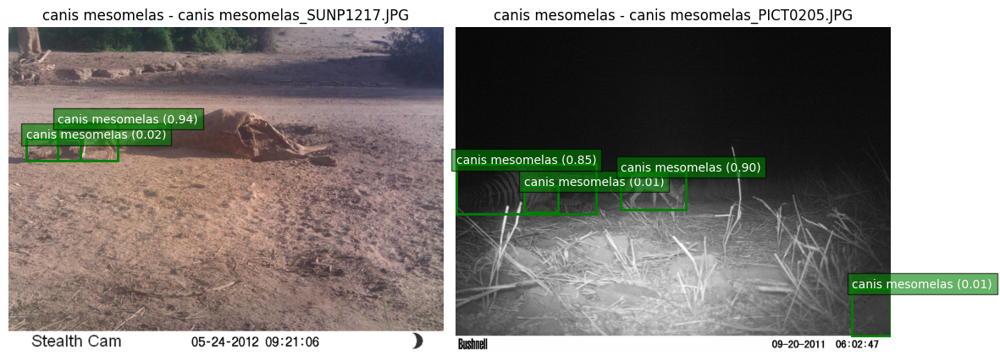

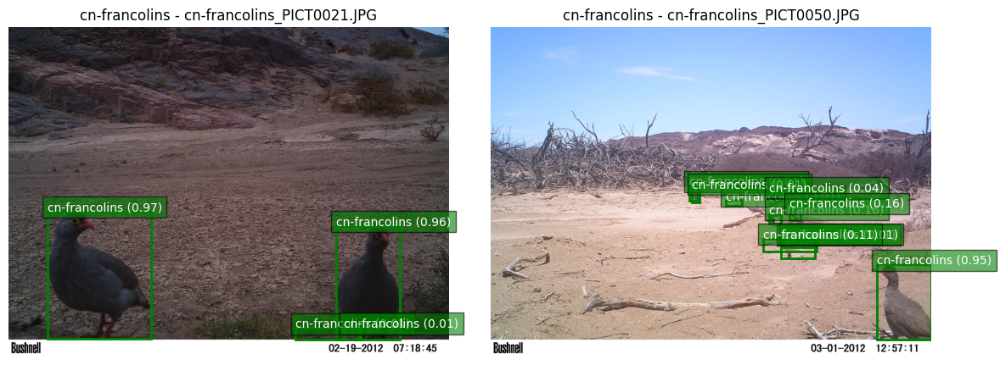

...

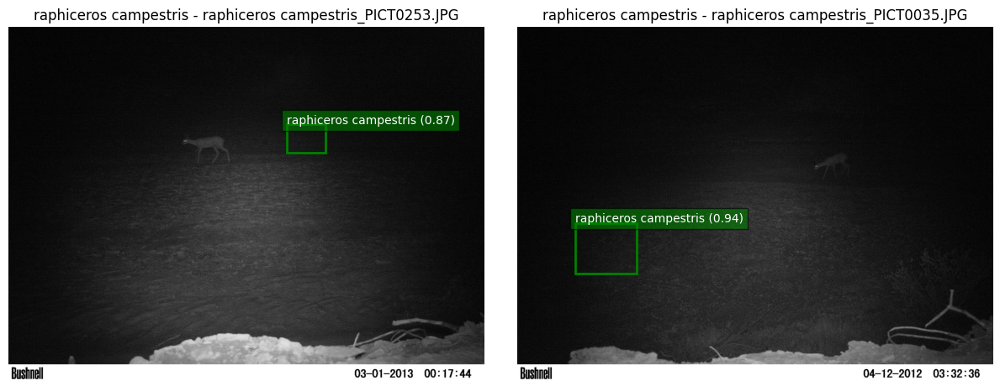

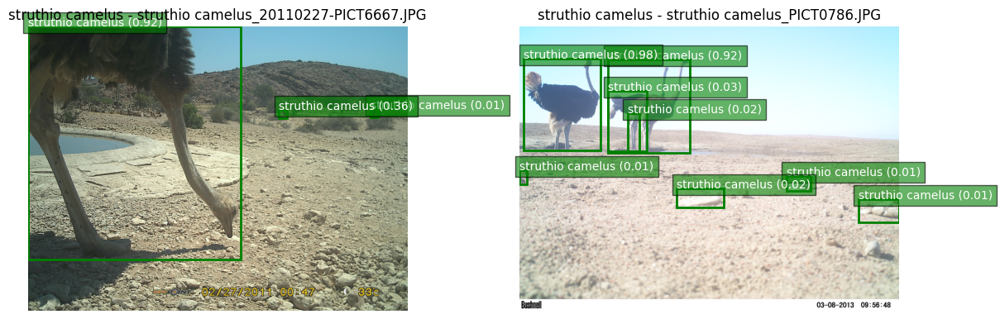

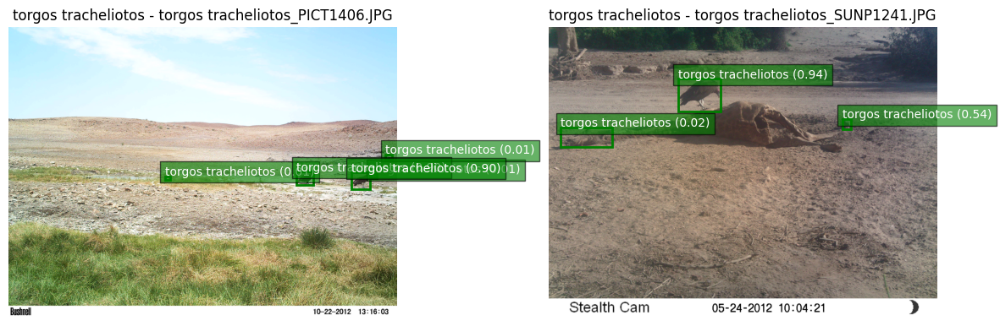

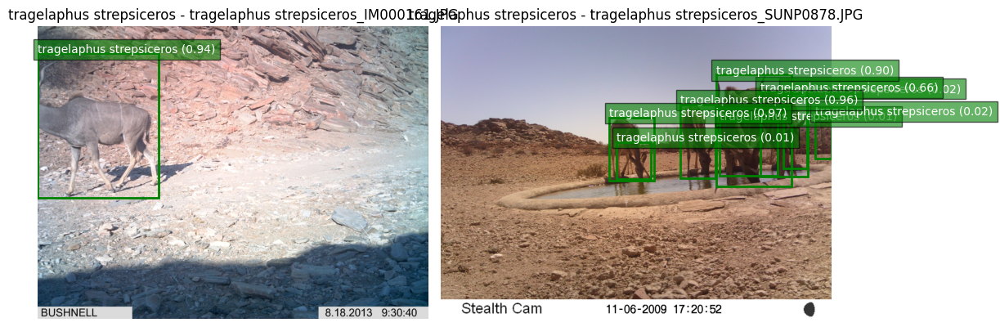

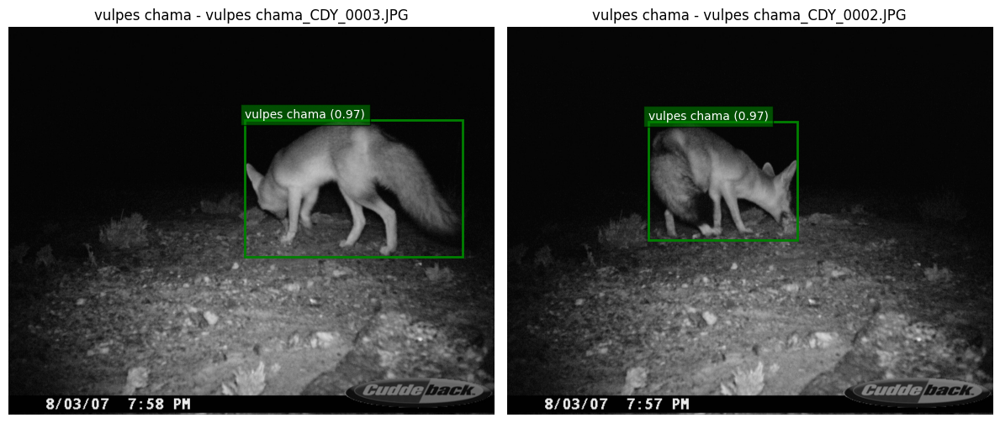

In [ ]:
# Pfad zum "balanced_dataset" Ordner
image_root = "balanced_dataset"

# Pfad zur neuen JSON-Datei
json_path = "JSONs/balanced_dataset_detections_new.json"

# Öffnen und Laden der JSON-Daten
with open(json_path, "r") as f:
    data = json.load(f)

# Erstellen des Mappings von Kategorien-IDs zu Namen (Nur gültige Kategorien)
valid_category_names = set(os.listdir(image_root))

category_mapping = {cat["id"]: cat["name"]
                    for cat in data["categories"]
                    if cat["name"] in valid_category_names}

# Gehe alle Kategorien im Verzeichnis "balanced_dataset" durch
for category in os.listdir(image_root):
    category_path = os.path.join(image_root, category)

    # Nur fortfahren, wenn es auch Bilder in dieser Kategorie gibt
    if os.path.isdir(category_path) and category in valid_category_names:
        image_files = [f for f in os.listdir(category_path) if f.endswith(('jpg', 'JPG', 'jpeg'))]
        
        # Falls keine Bilder in der Kategorie existieren, überspringen 
        if len(image_files) == 0:
            print(f"Keine Bilder in der Kategorie {category} gefunden. Überspringe diese Kategorie.")
            continue
        
        # Wähle zufällig 2 Bilder aus
        selected_images = random.sample(image_files, 2)

        # Erstelle ein Subplot mit 2 Bildern nebeneinander
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))
        for ax, img_file in zip(axes, selected_images):
            img_abs_path = os.path.join(category_path, img_file)
            
            # Bild laden
            img = cv2.imread(img_abs_path)
            if img is None:
                print(f"Konnte Bild nicht laden: {img_abs_path}")
                continue
            
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            # Holen der Detections für dieses Bild
            img_rel_path = os.path.relpath(img_abs_path, image_root).replace("\\", "/")  
            img_detections = None

            # JSON-Daten nach den Detections durchsuchen
            for img_data in data["images"]:
                if img_data["file"] == img_rel_path:
                    img_detections = img_data.get("detections", [])
                    break

            if img_detections is None:
                print(f"Keine Detections für das Bild {img_rel_path} gefunden.")
            else:
                # Bild anzeigen
                ax.imshow(img_rgb)
                ax.axis('off')  # Achsen ausblenden
                ax.set_title(f"{category} - {img_file}")

                # Bounding Boxes und Confidence anzeigen
                for det in img_detections:
                    x, y, w, h = det["bbox"]
                    confidence = det["conf"]

                    # Holen der richtigen Kategorie-ID aus den Annotations
                    annotation = next((ann for ann in data["annotations"] if ann["image_id"] == img_data["file"]), None)
                    
                    if annotation is not None:
                        category_id = annotation["category_id"]
                        category_name = category_mapping.get(category_id, "Unknown")

                        # Bounding Box-Koordinaten berechnen
                        x1, y1 = x * img.shape[1], y * img.shape[0]
                        x2, y2 = (x + w) * img.shape[1], (y + h) * img.shape[0]

                        # Bounding Box zeichnen
                        rect = plt.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='g', facecolor='none')
                        ax.add_patch(rect)

                        # Text mit Kategorie und Confidence
                        label_text = f"{category_name} ({confidence:.2f})"
                        ax.text(x1, y1 - 5, label_text, fontsize=10, color='white', bbox=dict(facecolor='green', alpha=0.6))

        plt.tight_layout()  
        plt.show()  


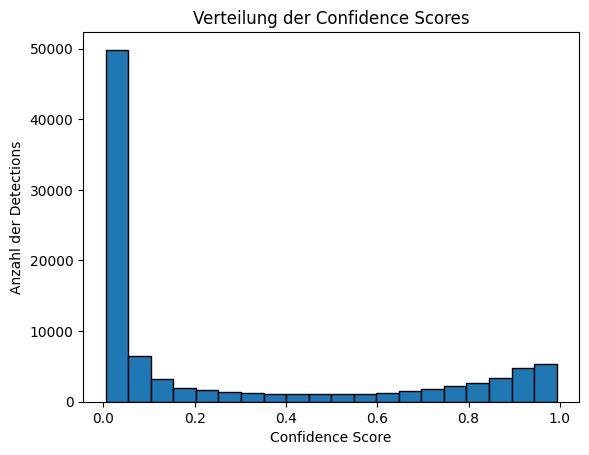

In [13]:

confidences = [det["conf"] for img in data["images"] for det in img.get("detections", [])]

plt.hist(confidences, bins=20, edgecolor="black")
plt.xlabel("Confidence Score")
plt.ylabel("Anzahl der Detections")
plt.title("Verteilung der Confidence Scores")
plt.show()


### Schlechte Detections entfernen

Confidence threshold: 0.6

In [ ]:
# Setze den Confidence-Threshold
CONFIDENCE_THRESHOLD = 0.6

# Pfad zum "balanced_dataset" Ordner
image_root = "balanced_dataset"

# Pfad zur neuen JSON-Datei
json_path = "JSONs/balanced_dataset_detections_new.json"

# Pfad zur neuen JSON-Datei
filtered_json_path = "JSONs/balanced_dataset_detections_60.json"

# JSON-Daten laden
with open(json_path, "r") as f:
    data = json.load(f)

# Neues Dictionary für die gefilterten Daten
filtered_data = {
    "images": [],
    "annotations": [],
    "categories": data["categories"]
}

# Set gültiger Kategorien aus dem Verzeichnisnamen
valid_category_names = set(os.listdir(image_root))

# Mapping von ID zu Name, nur für gültige Kategorien
valid_category_ids = {
    cat["id"] for cat in data["categories"] if cat["name"] in valid_category_names
}
category_mapping = {
    cat["id"]: cat["name"] for cat in data["categories"] if cat["id"] in valid_category_ids
}

# Alle Bilder durchgehen
for image in data["images"]:
    img_detections = image.get("detections", [])
    high_conf_detections = [det for det in img_detections if det["conf"] >= CONFIDENCE_THRESHOLD]

    if high_conf_detections:
        # Bild behalten, wenn mindestens eine Detection übrig bleibt
        filtered_image = image.copy()
        filtered_image["detections"] = high_conf_detections
        filtered_data["images"].append(filtered_image)

        # Passende Annotationen hinzufügen 
        image_id = image["file"]
        for ann in data["annotations"]:
            if ann["image_id"] == image_id and ann["category_id"] in valid_category_ids:
                filtered_data["annotations"].append(ann)

# Speichere die gefilterte JSON-Datei
with open(filtered_json_path, "w") as f:
    json.dump(filtered_data, f, indent=2)

print(f"Gefilterte JSON-Datei gespeichert unter: {filtered_json_path}")


Gefilterte JSON-Datei gespeichert unter: JSONs/balanced_dataset_detections_60.json


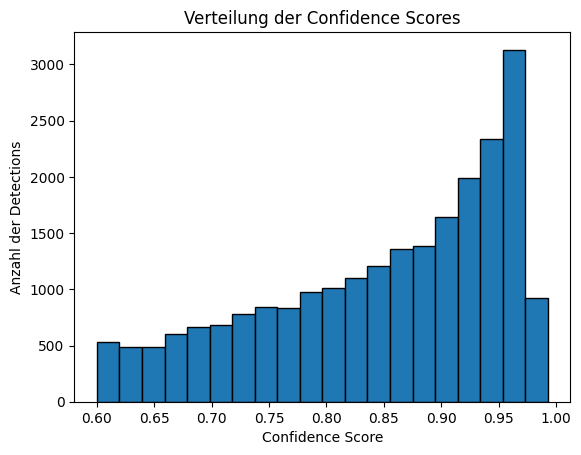

In [6]:
# Pfad zur neuen JSON-Datei
json_path = "JSONs/balanced_dataset_detections_60.json"

# JSON-Daten laden
with open(json_path, "r") as f:
    data = json.load(f)

confidences = [det["conf"] for img in data["images"] for det in img.get("detections", [])]

plt.hist(confidences, bins=20, edgecolor="black")
plt.xlabel("Confidence Score")
plt.ylabel("Anzahl der Detections")
plt.title("Verteilung der Confidence Scores")
plt.show()